# The Future of Harveston - DataCrunch 2025 by CSE UOM

This is our submission for DataCrunch 2025.

*~ Caramel Labs*

---

## Getting Started

In [180]:
# Check whether runtime is connected
print("Hello World!")

Hello World!


In [181]:
# Install Facebook Prophet

%%capture
!pip install fbprophet

In [182]:
# All imports

import os
import random
import logging
import numpy as np
import pandas as pd
import seaborn as sns
from tqdm import tqdm
from scipy import stats
from prophet import Prophet
from google.colab import drive
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from scipy.stats.mstats import winsorize
from statsmodels.tsa.arima.model import ARIMA
from sklearn.preprocessing import MinMaxScaler

In [183]:
# Mount Google Drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [184]:
# Set seeds for reproducibility

random.seed(42)
np.random.seed(42)

### Loading the Data

In [185]:
# Load training data
train_df = pd.read_csv("/content/drive/MyDrive/DataCrunch/train.csv")

train_df.head()

,ID,Year,Month,Day,kingdom,latitude,longitude,Avg_Temperature,Avg_Feels_Like_Temperature,Temperature_Range,Feels_Like_Temperature_Range,Radiation,Rain_Amount,Rain_Duration,Wind_Speed,Wind_Direction,Evapotranspiration
0,1,1,4,1,Arcadia,24.280002,-37.229980,25.50,30.50,8.5,10.3,22.52,58.89,16,8.6,283,1.648659
1,2,1,4,1,Atlantis,22.979999,-37.329990,299.65,305.15,5.9,8.2,22.73,11.83,12,15.8,161,1.583094
2,3,1,4,1,Avalon,22.880000,-37.130006,26.30,31.50,5.2,6.4,22.73,11.83,12,15.8,161,1.593309
3,4,1,4,1,Camelot,24.180003,-36.929994,24.00,28.40,8.2,10.7,22.67,75.27,16,6.4,346,1.638997
4,5,1,4,1,Dorne,25.780002,-37.530000,28.00,32.80,5.7,10.2,22.35,4.81,8,16.7,185,1.719189


A good way to start off EDA is by inspecting the shape of our dataframe.

In [186]:
# Inspect training data shape
train_df.shape

(84960, 17)

Here, we can see that our dataframe has:

1. 84,960 samples (rows)
2. 17 features (columns)

We can get more information related to the data, such as the data types of the features, missing values etc. using `train_df.info()`.

In [187]:
# Get overview of training data
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84960 entries, 0 to 84959
Data columns (total 17 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   ID                            84960 non-null  int64  
 1   Year                          84960 non-null  int64  
 2   Month                         84960 non-null  int64  
 3   Day                           84960 non-null  int64  
 4   kingdom                       84960 non-null  object 
 5   latitude                      84960 non-null  float64
 6   longitude                     84960 non-null  float64
 7   Avg_Temperature               84960 non-null  float64
 8   Avg_Feels_Like_Temperature    84960 non-null  float64
 9   Temperature_Range             84960 non-null  float64
 10  Feels_Like_Temperature_Range  84960 non-null  float64
 11  Radiation                     84960 non-null  float64
 12  Rain_Amount                   84960 non-null  float64
 13  R

The output of `train_df.info()` yields the following information:

1. We only have one categorical variable - `kingdom` i.e. the names of the kingdoms of Harveston. The rest of the variables are continuous - either integer or float.
2. There appears to be no missing values in any of the columns of the dataframe.

Additional, we can also get a **statistical summary** of our data using `train_df.describe()`.

In [188]:
# Get statistical summary of training data
train_df.describe()

,ID,Year,Month,Day,latitude,longitude,Avg_Temperature,Avg_Feels_Like_Temperature,Temperature_Range,Feels_Like_Temperature_Range,Radiation,Rain_Amount,Rain_Duration,Wind_Speed,Wind_Direction,Evapotranspiration
count,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000,84960.000000
mean,42480.500000,4.610876,6.666667,15.735876,24.003334,-37.266665,135.600751,139.735375,5.345287,6.361224,20.338598,7.723850,8.895680,15.629291,215.831297,1.568724
std,24525.983772,2.239331,3.402793,8.802867,0.798622,0.488873,133.650417,133.937168,1.977739,2.371880,4.118938,13.477186,7.231531,6.198760,93.917858,0.219856
min,1.000000,1.000000,1.000000,1.000000,22.880000,-37.729980,18.600000,18.700000,0.500000,0.800000,3.190000,0.000000,0.000000,2.300000,0.000000,0.425268
25%,21240.750000,3.000000,4.000000,8.000000,23.680003,-37.630006,26.300000,30.300000,3.800000,4.500000,18.070000,0.520000,2.000000,11.100000,119.000000,1.451614
50%,42480.500000,5.000000,7.000000,16.000000,23.780002,-37.530000,28.100000,32.500000,5.100000,6.200000,20.960000,3.380000,8.000000,15.100000,255.000000,1.589235
75%,63720.250000,7.000000,10.000000,23.000000,24.280002,-37.130006,299.350000,303.850000,6.500000,8.000000,23.300000,9.490000,15.000000,19.000000,286.000000,1.715598
max,84960.000000,8.000000,12.000000,31.000000,26.580005,-35.729980,303.650000,309.650000,15.400000,17.300000,30.100000,440.440000,24.000000,50.200000,359.000000,2.212660


Next, we'll load and inspect the testing data (the data on which predictions have to be made).

In [189]:
# Load testing data
test_df = pd.read_csv("/content/drive/MyDrive/DataCrunch/test.csv")

test_df.head()

,ID,Year,Month,Day,kingdom
0,84961,9,1,1,Arcadia
1,84962,9,1,1,Atlantis
2,84963,9,1,1,Avalon
3,84964,9,1,1,Camelot
4,84965,9,1,1,Dorne


In [190]:
# Inspect testing data shape
test_df.shape

(4530, 5)

---

## Exploratory Data Analysis and Data Preprocessing

In [191]:
# Get list of unique kingdoms
kingdoms = train_df["kingdom"].unique()

print(kingdoms)

['Arcadia' 'Atlantis' 'Avalon' 'Camelot' 'Dorne' 'Eden' 'El Dorado'
 'Elysium' 'Emerald City' 'Helios' 'Krypton' 'Metropolis' 'Midgar'
 'Midgard' 'Mordor' 'Neo-City' 'Neo-Tokyo' 'Nirvana' 'Olympus' 'Pandora'
 'Rapture' 'Rivendell' 'Serenity' 'Shangri-La' 'Solara' 'Solstice'
 'Sunspear' 'Utopia' 'Valyria' 'Winterfell']


### Processing DateTime Information

An important verification we need to do is to check the unique values of the `Year`, `Month` and `Day` columns, to make sure they don't include any weird and unexpected information (e.g. a `Day` that's not between 1 and 31).

In [192]:
date_cols = ["Year", "Month", "Day"]

for col in date_cols:
  # Retrieve list of unique values for `Year` column
  unique_values = train_df[col].unique()

  # Display result
  print(f"Unique values of `{col}` column: {unique_values}")

Unique values of `Year` column: [1 2 3 4 5 6 7 8]
Unique values of `Month` column: [ 4  5  6  7  8  9 10 11 12  1  2  3]
Unique values of `Day` column: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31]


There doesn't seem to be any unexpected anomalies in the `Year`, `Month` and `Day` columns, which means we can use them as they are to create a `Date` feature by combining them.

This `Date` feature will be the index of our data, which is crucial when working on time-series datasets.

In [193]:
# Assume the earliest year is 2000
base_year = 2000

# Create `ds` feature from date information
train_df['ds'] = pd.to_datetime(
    (train_df['Year'] + base_year).astype(str) + '-' +
    train_df['Month'].astype(str) + '-' +
    train_df['Day'].astype(str),
    format='%Y-%m-%d',
    errors='coerce'  # Handle invalid dates (e.g. Feb 29 on a non-leap year)
)

# Remove rows where 'ds' is NaN
train_df = train_df.dropna(subset=['ds'])

train_df.head()

,ID,Year,Month,Day,kingdom,latitude,longitude,Avg_Temperature,Avg_Feels_Like_Temperature,Temperature_Range,Feels_Like_Temperature_Range,Radiation,Rain_Amount,Rain_Duration,Wind_Speed,Wind_Direction,Evapotranspiration,ds
0,1,1,4,1,Arcadia,24.280002,-37.229980,25.50,30.50,8.5,10.3,22.52,58.89,16,8.6,283,1.648659,2001-04-01
1,2,1,4,1,Atlantis,22.979999,-37.329990,299.65,305.15,5.9,8.2,22.73,11.83,12,15.8,161,1.583094,2001-04-01
2,3,1,4,1,Avalon,22.880000,-37.130006,26.30,31.50,5.2,6.4,22.73,11.83,12,15.8,161,1.593309,2001-04-01
3,4,1,4,1,Camelot,24.180003,-36.929994,24.00,28.40,8.2,10.7,22.67,75.27,16,6.4,346,1.638997,2001-04-01
4,5,1,4,1,Dorne,25.780002,-37.530000,28.00,32.80,5.7,10.2,22.35,4.81,8,16.7,185,1.719189,2001-04-01


In [194]:
# Inspect training data shape after processing dates
train_df.shape

(84900, 18)

In [195]:
# Assume the earliest year is 2000
base_year = 2000

# Create `ds` feature from date information
test_df['ds'] = pd.to_datetime(
    (test_df['Year'] + base_year).astype(str) + '-' +
    test_df['Month'].astype(str) + '-' +
    test_df['Day'].astype(str),
    format='%Y-%m-%d',
    errors='coerce'  # Handle invalid dates (e.g., Feb 30)
)

# Remove rows where 'ds' is NaN
test_df = test_df.dropna(subset=['ds'])

test_df.head()

,ID,Year,Month,Day,kingdom,ds
0,84961,9,1,1,Arcadia,2009-01-01
1,84962,9,1,1,Atlantis,2009-01-01
2,84963,9,1,1,Avalon,2009-01-01
3,84964,9,1,1,Camelot,2009-01-01
4,84965,9,1,1,Dorne,2009-01-01


In [196]:
# Inspect training data shape after processing dates
test_df.shape

(4530, 6)

### Removing Unnecessary Data

Since we are working with time-series, we can drop any data that is:

1. Not the `ds` column.
2. Not one of the targets to be predicted.
3. Not a column used to filter the data further - in this case, the `kingdom`.

In [197]:
# Define target columns
targets = ["Avg_Temperature", "Radiation", "Rain_Amount", "Wind_Speed", "Wind_Direction"]

In [198]:
# Drop unnecessary columns

cols_to_keep = targets + ["ds", "kingdom"]
train_df = train_df.loc[:, cols_to_keep]

train_df.head()

,Avg_Temperature,Radiation,Rain_Amount,Wind_Speed,Wind_Direction,ds,kingdom
0,25.50,22.52,58.89,8.6,283,2001-04-01,Arcadia
1,299.65,22.73,11.83,15.8,161,2001-04-01,Atlantis
2,26.30,22.73,11.83,15.8,161,2001-04-01,Avalon
3,24.00,22.67,75.27,6.4,346,2001-04-01,Camelot
4,28.00,22.35,4.81,16.7,185,2001-04-01,Dorne


### Handling Temperatures

The competition guidelines doc mentioned about temperatures being in **both Kelvin and Celcius**, which must be handled appropriately before any model training.

We can confirm this by plotting out the `Avg_Temperature` column's distribution:

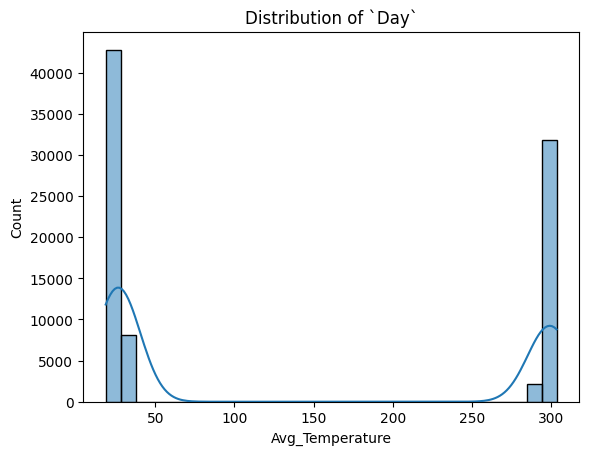

In [199]:
# Plot distribution of `Avg_Temperature`

plt.figure()
sns.histplot(train_df["Avg_Temperature"], kde=True, bins=30)
plt.title(f"Distribution of `{col}`")
plt.show()

Here, we can clearly see from the abnormal distribution, that `Avg_Temperature` has values of both Kelvin and Celcius.

To address, let's convert all Kelvin values (values greater than say, `100`) to Celcius.

In [200]:
# Convert all temperatures > 100 from Kelvin to Celsius

train_df['Avg_Temperature'] = train_df['Avg_Temperature'].apply(
    lambda x: x - 273.15 if x > 100 else x
)

train_df.head()

,Avg_Temperature,Radiation,Rain_Amount,Wind_Speed,Wind_Direction,ds,kingdom
0,25.5,22.52,58.89,8.6,283,2001-04-01,Arcadia
1,26.5,22.73,11.83,15.8,161,2001-04-01,Atlantis
2,26.3,22.73,11.83,15.8,161,2001-04-01,Avalon
3,24.0,22.67,75.27,6.4,346,2001-04-01,Camelot
4,28.0,22.35,4.81,16.7,185,2001-04-01,Dorne


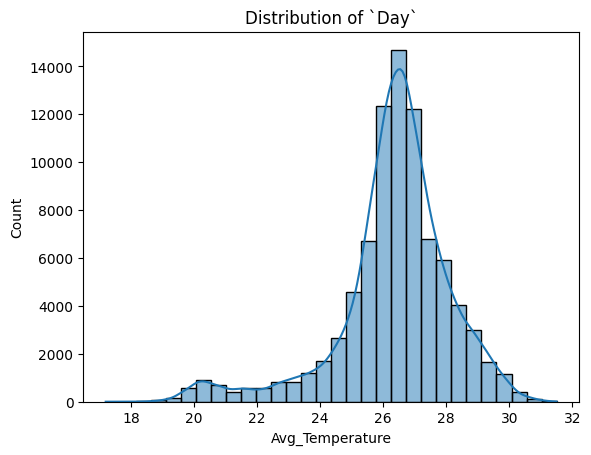

In [201]:
# Plot distribution of `Avg_Temperature` after conversion to Celcius

plt.figure()
sns.histplot(train_df["Avg_Temperature"], kde=True, bins=30)
plt.title(f"Distribution of `{col}`")
plt.show()

### Inspecting Seasonality

Next, let's see if the target columns show any clear signs of seasonality.

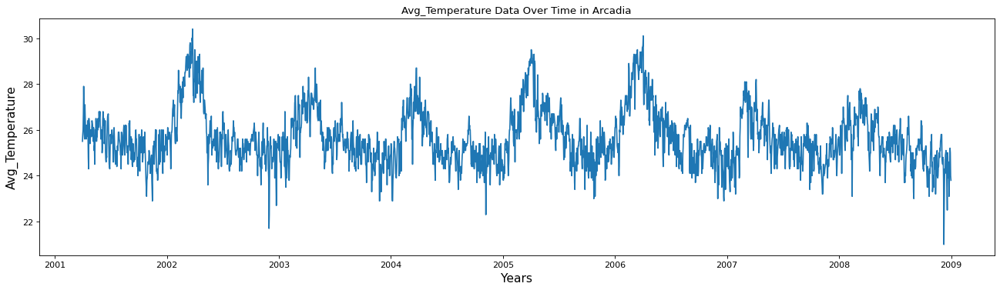

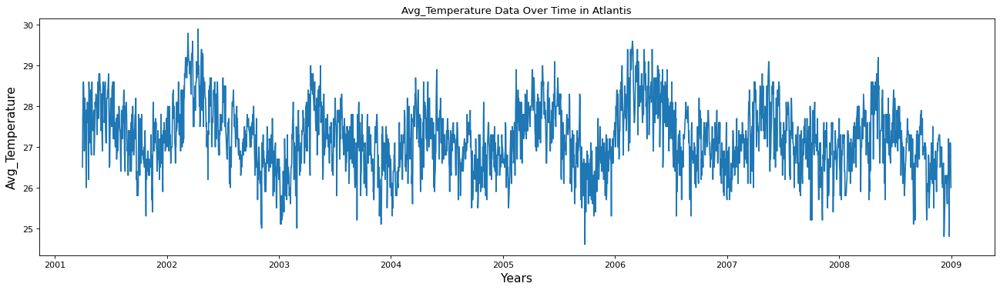

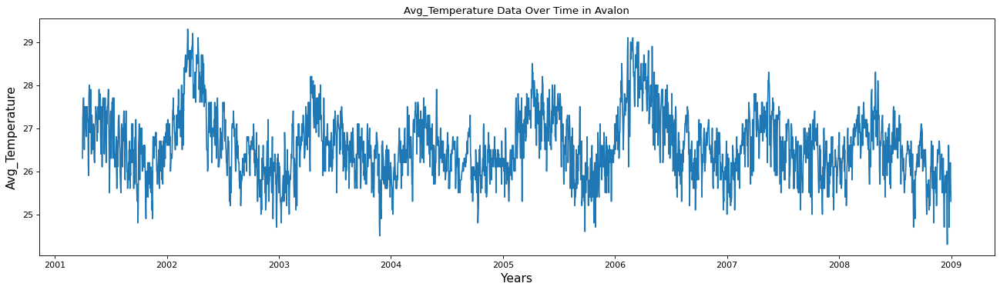

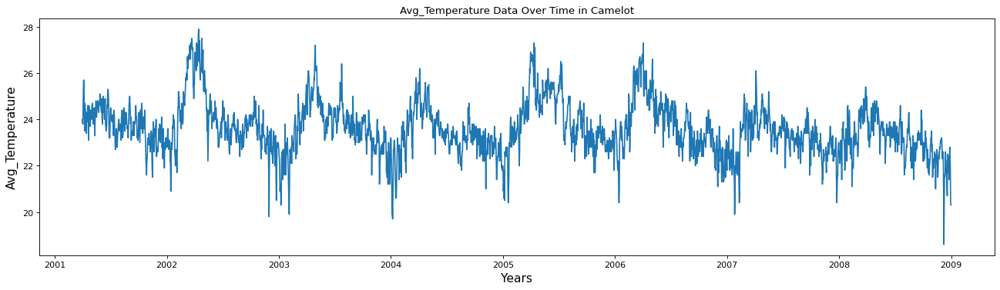

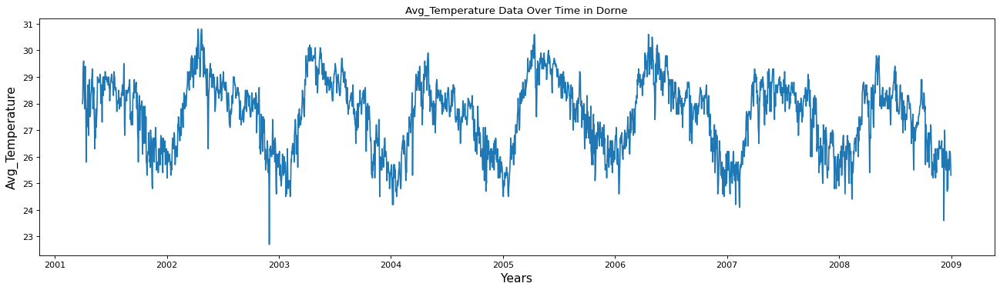

...

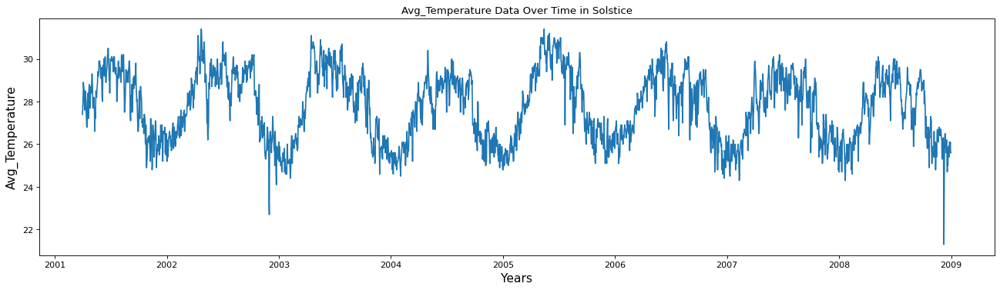

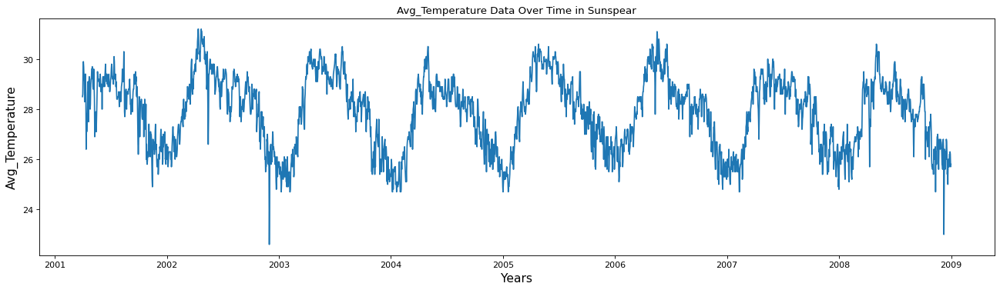

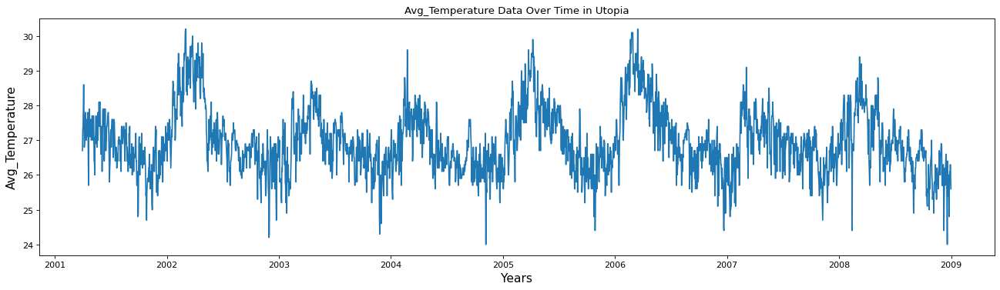

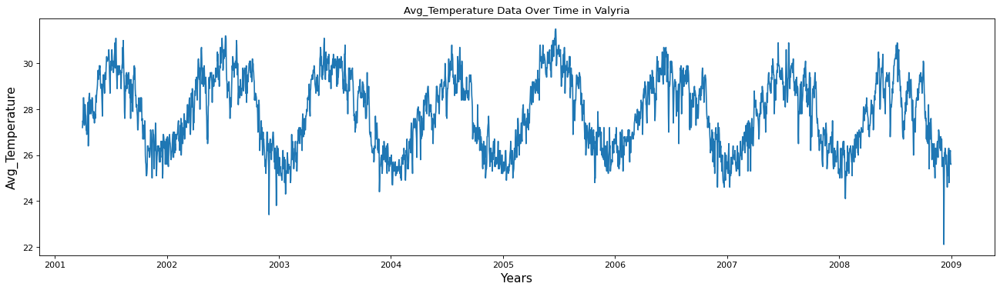

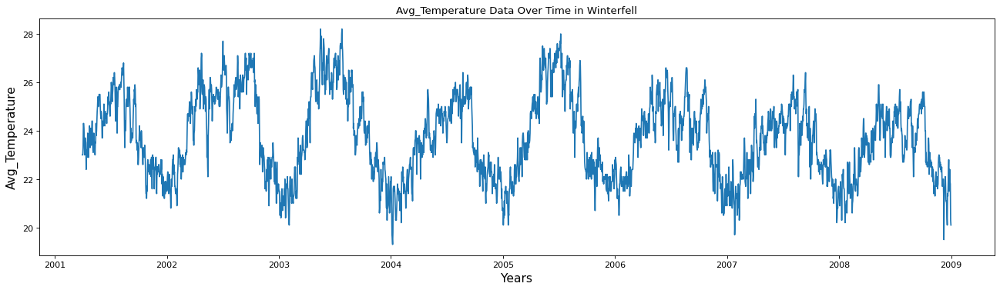

In [202]:
selected_target = "Avg_Temperature"

for kingdom in kingdoms:
  filtered_df = train_df.query(f"kingdom == '{kingdom}'")
  plt.figure(figsize=(20, 5), dpi=80, linewidth=10)
  plt.plot(filtered_df["ds"], filtered_df[selected_target])
  plt.title(f"{selected_target} Data Over Time in {kingdom}")
  plt.xlabel("Years", fontsize=14)
  plt.ylabel(f'{selected_target}', fontsize=14)
  plt.show()

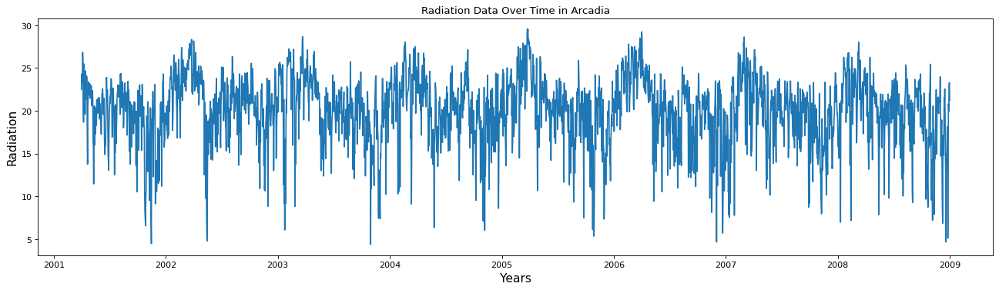

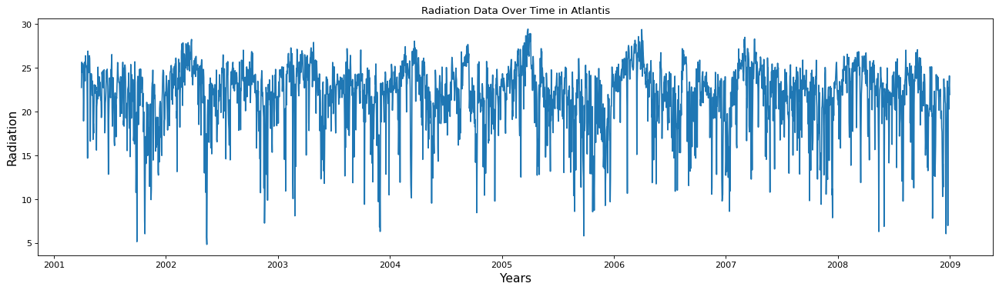

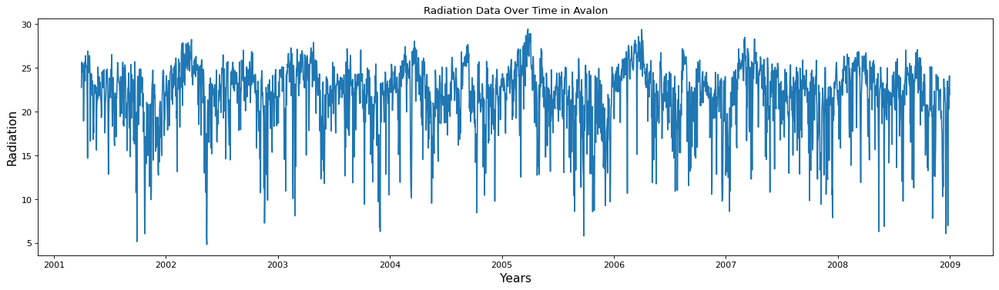

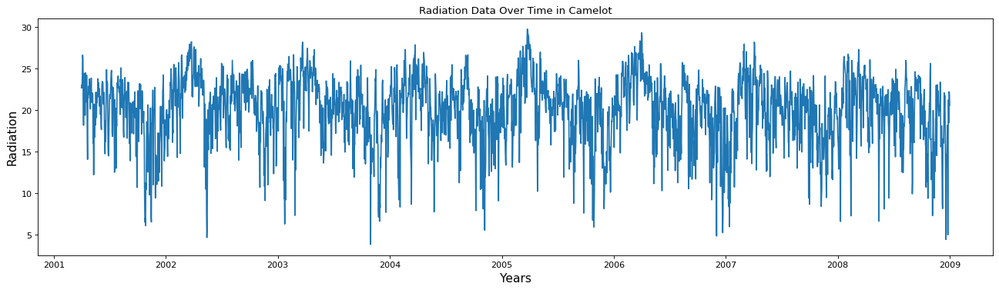

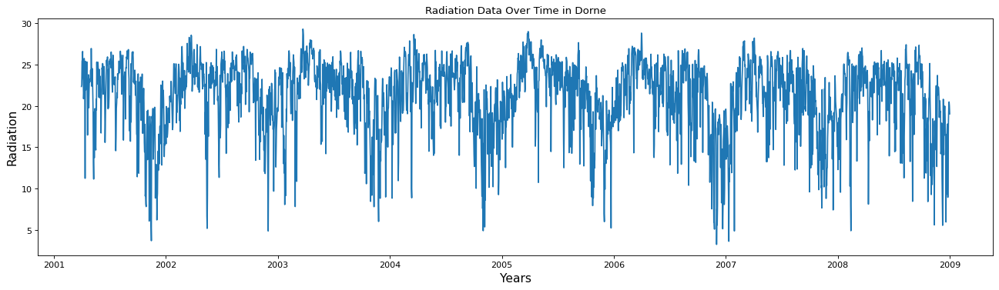

...

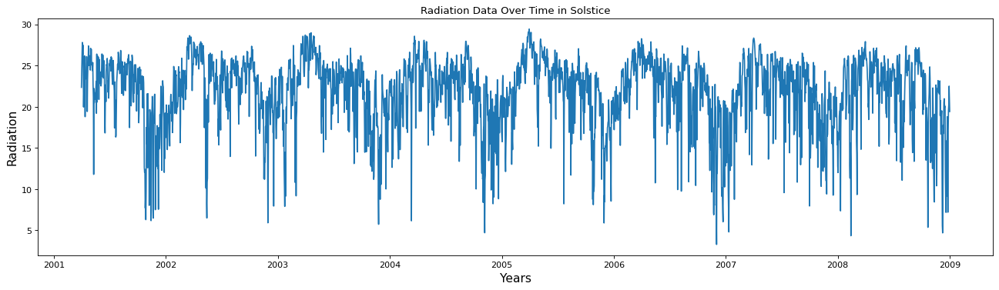

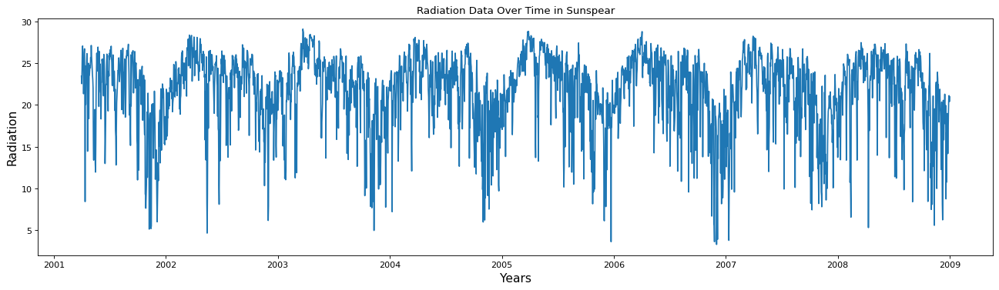

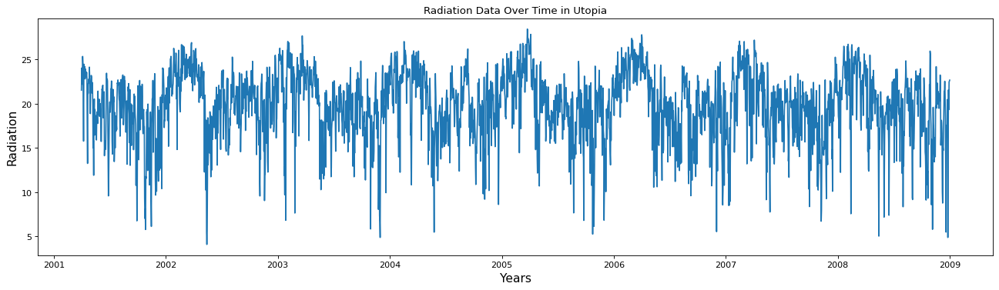

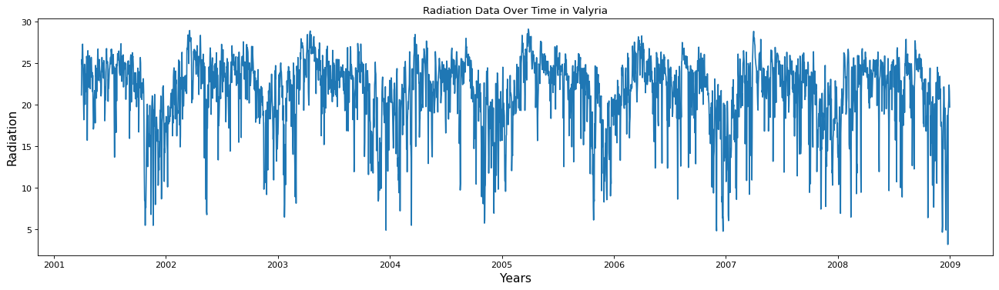

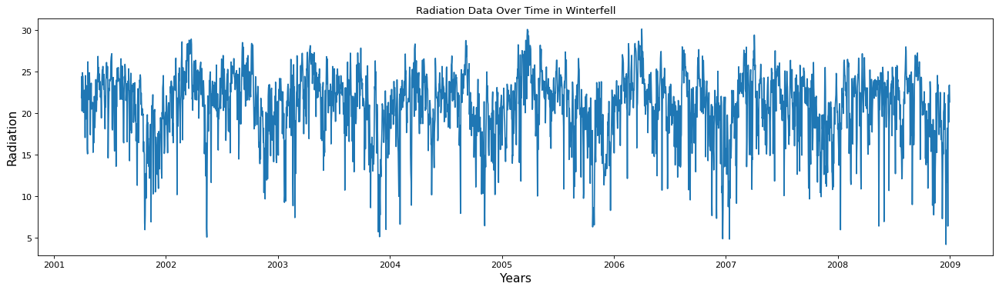

In [203]:
selected_target = "Radiation"

for kingdom in kingdoms:
  filtered_df = train_df.query(f"kingdom == '{kingdom}'")
  plt.figure(figsize=(20, 5), dpi=80, linewidth=10)
  plt.plot(filtered_df["ds"], filtered_df[selected_target])
  plt.title(f"{selected_target} Data Over Time in {kingdom}")
  plt.xlabel("Years", fontsize=14)
  plt.ylabel(f'{selected_target}', fontsize=14)
  plt.show()

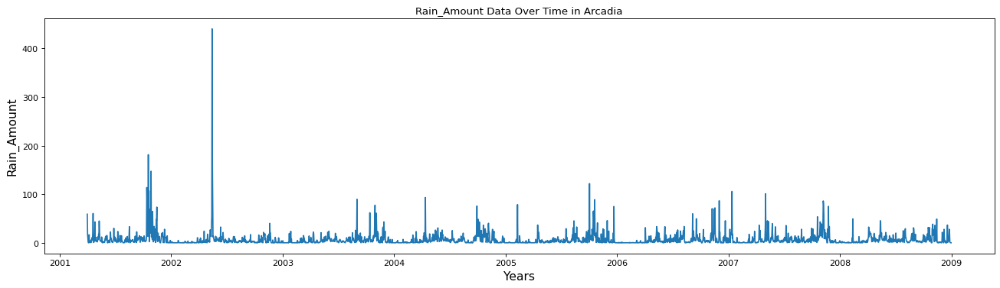

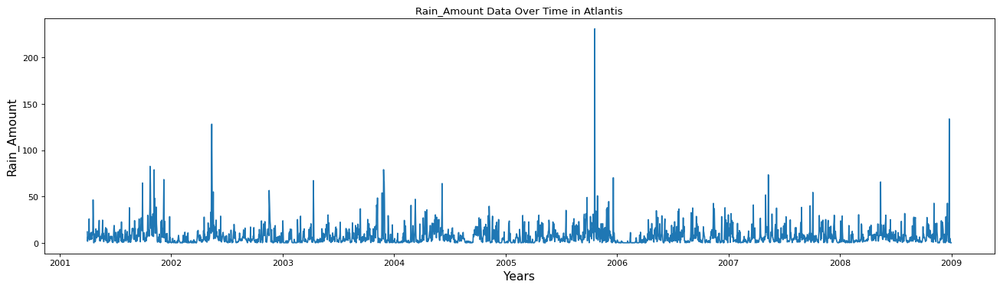

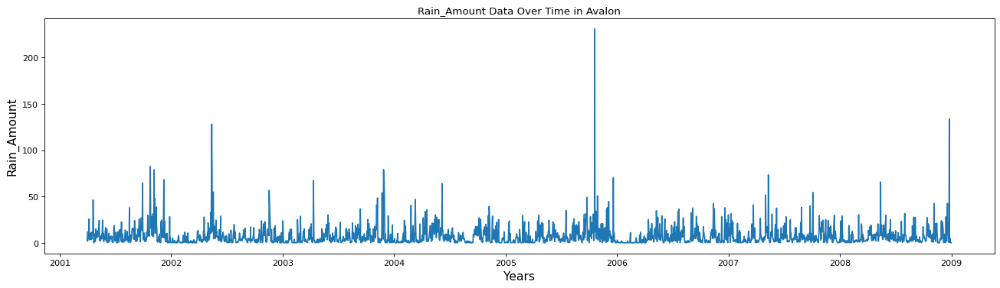

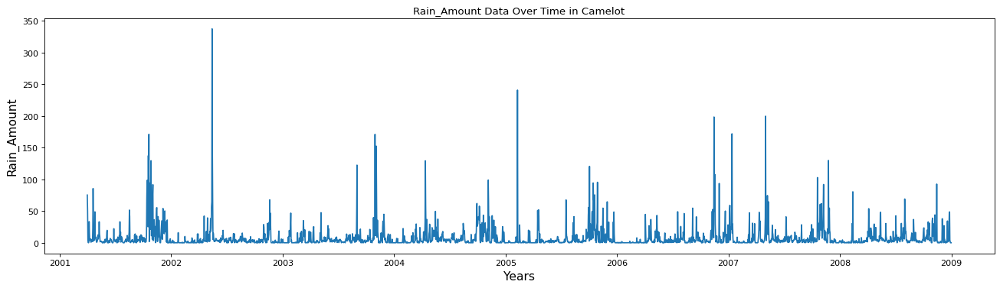

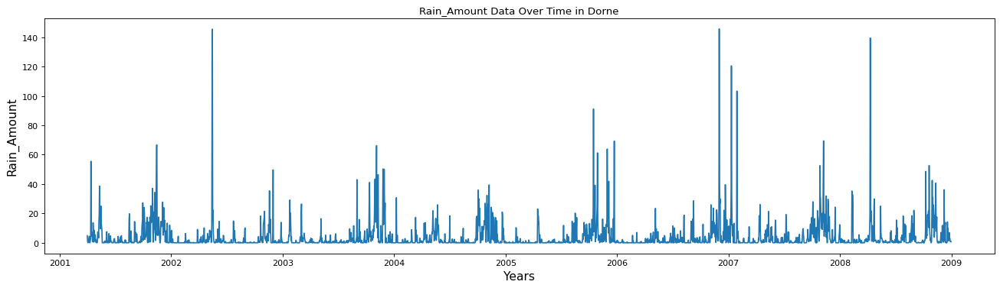

...

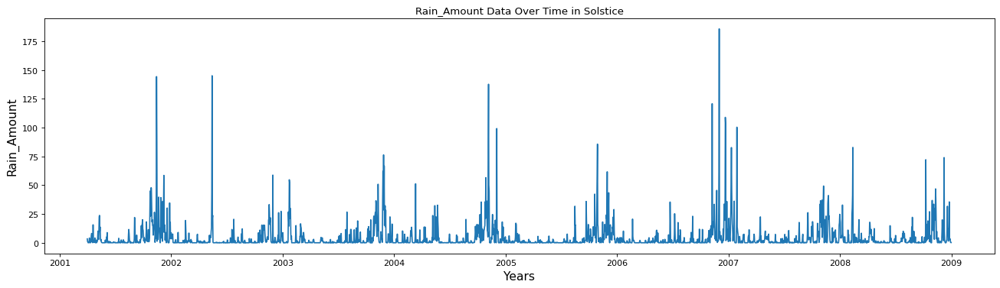

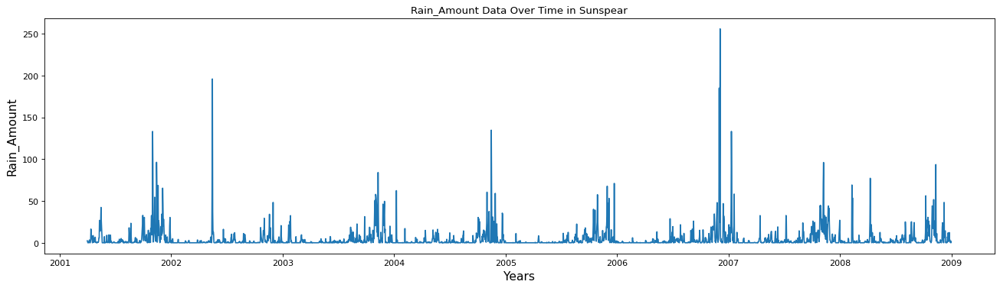

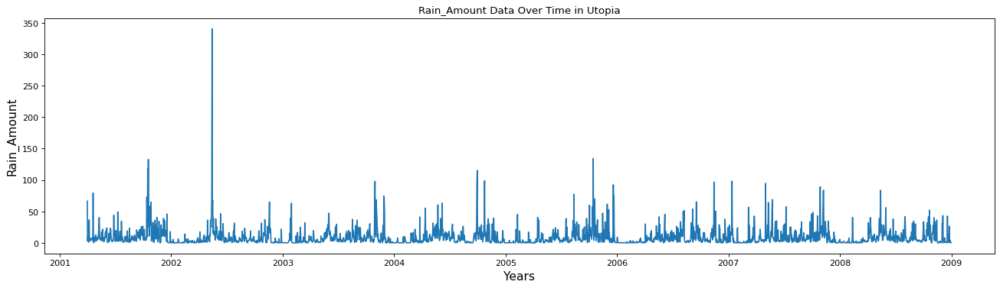

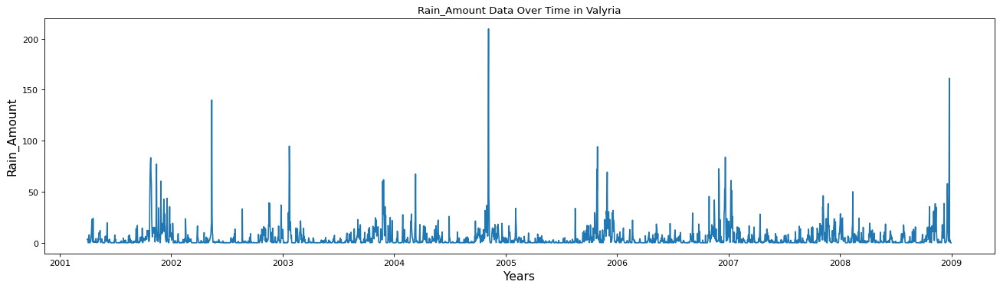

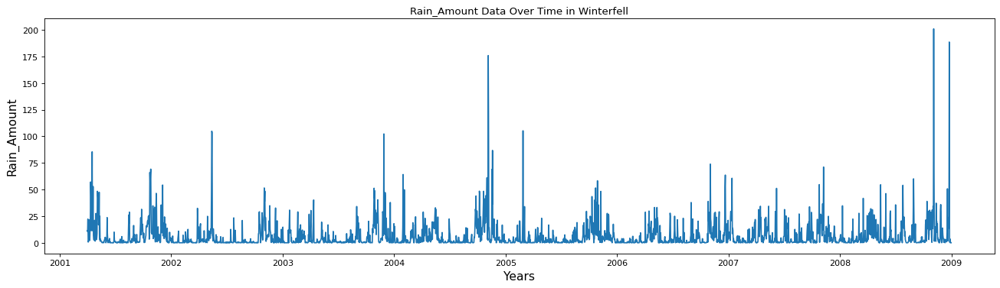

In [204]:
selected_target = "Rain_Amount"

for kingdom in kingdoms:
  filtered_df = train_df.query(f"kingdom == '{kingdom}'")
  plt.figure(figsize=(20, 5), dpi=80, linewidth=10)
  plt.plot(filtered_df["ds"], filtered_df[selected_target])
  plt.title(f"{selected_target} Data Over Time in {kingdom}")
  plt.xlabel("Years", fontsize=14)
  plt.ylabel(f'{selected_target}', fontsize=14)
  plt.show()

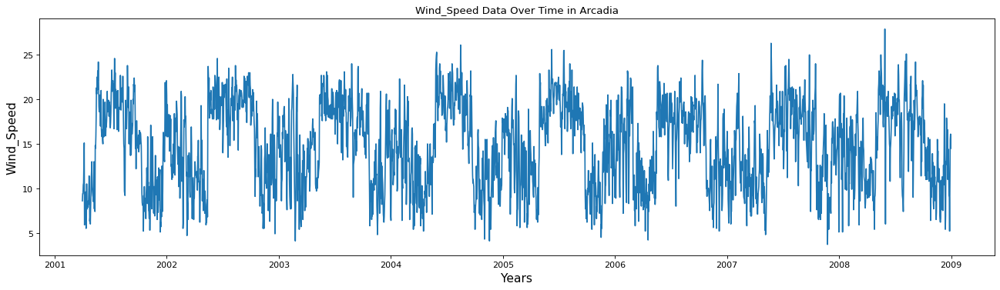

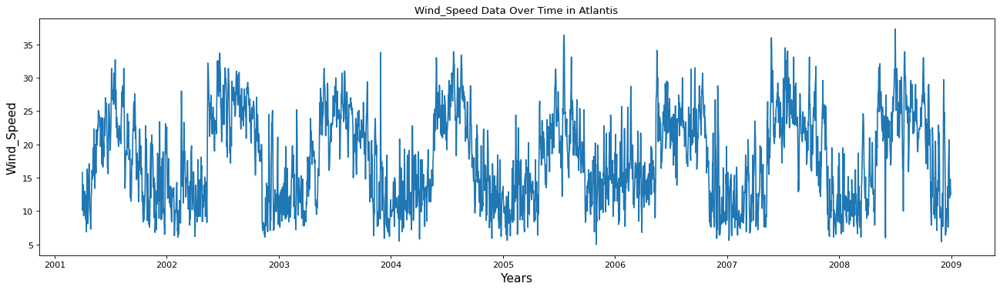

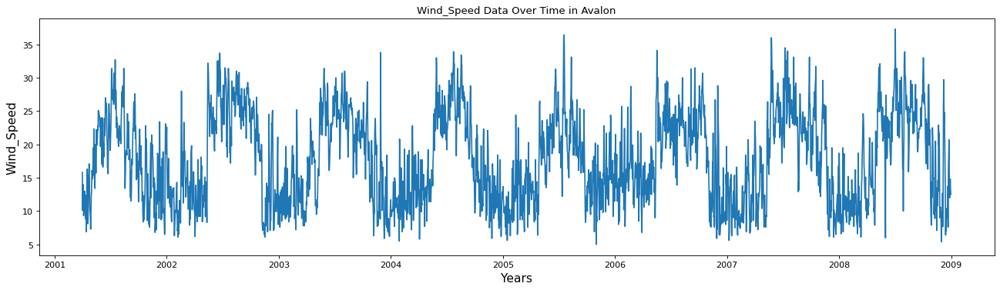

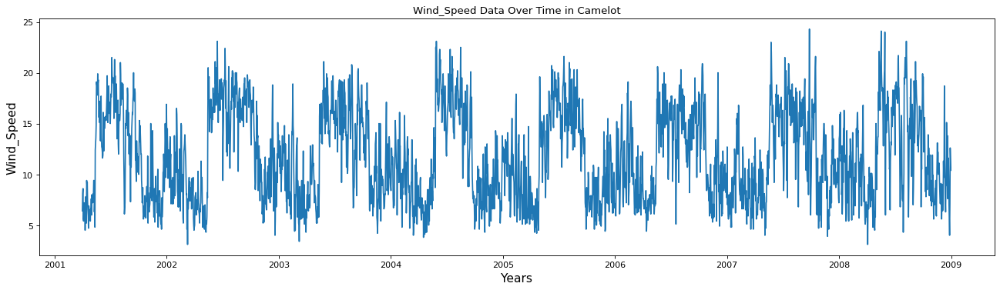

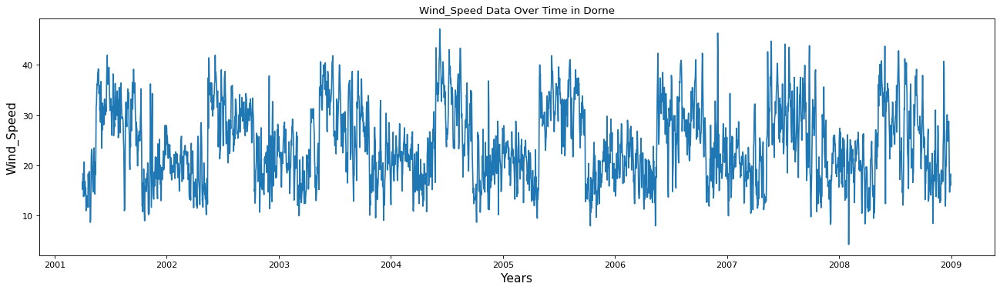

...

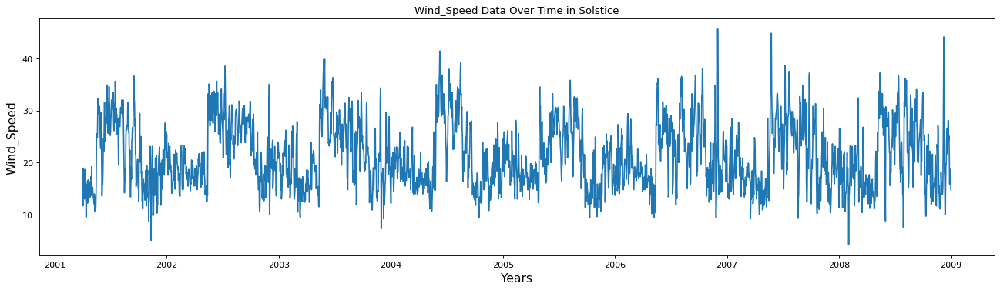

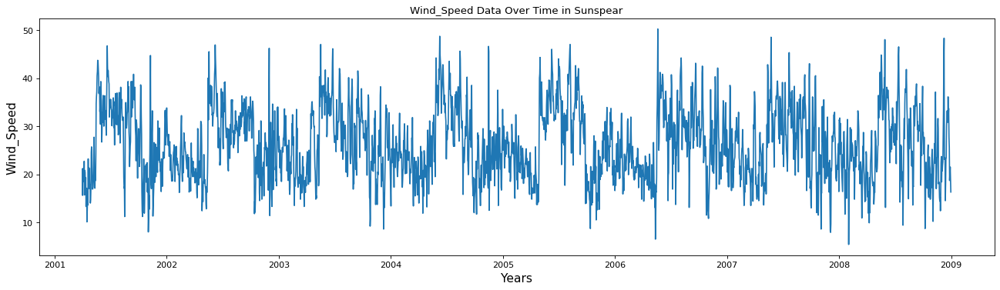

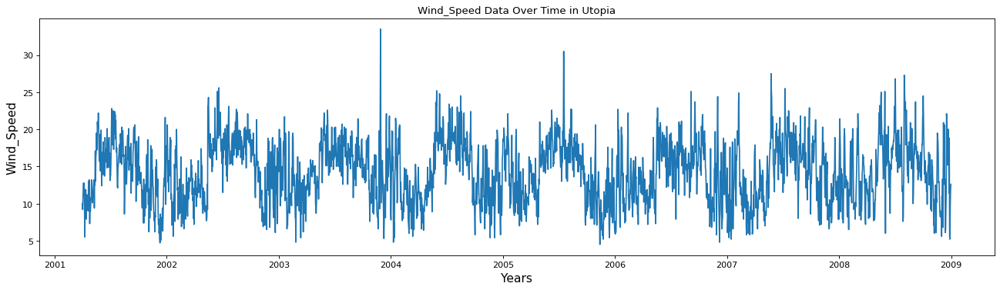

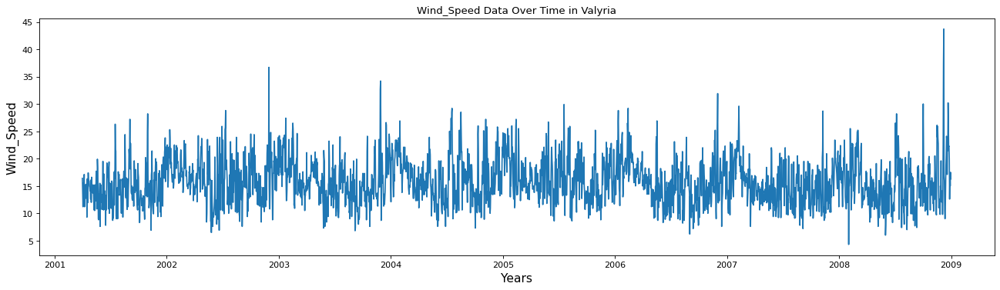

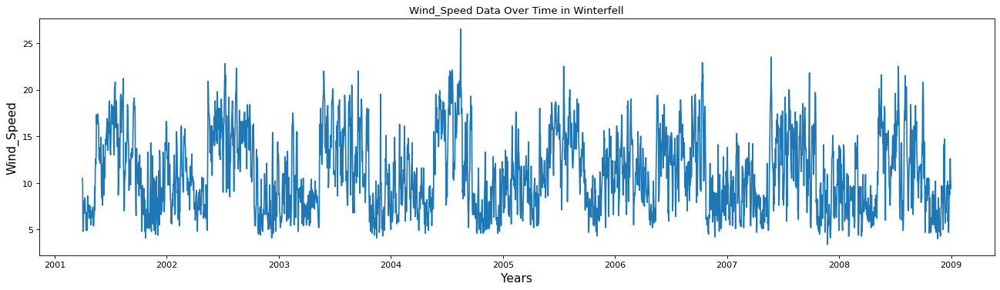

In [205]:
selected_target = "Wind_Speed"

for kingdom in kingdoms:
  filtered_df = train_df.query(f"kingdom == '{kingdom}'")
  plt.figure(figsize=(20, 5), dpi=80, linewidth=10)
  plt.plot(filtered_df["ds"], filtered_df[selected_target])
  plt.title(f"{selected_target} Data Over Time in {kingdom}")
  plt.xlabel("Years", fontsize=14)
  plt.ylabel(f'{selected_target}', fontsize=14)
  plt.show()

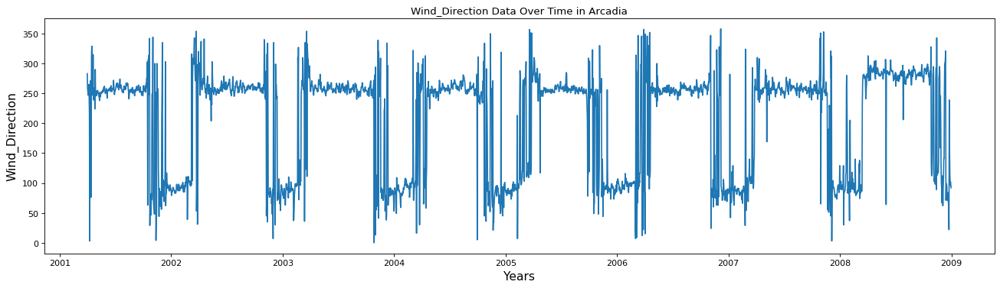

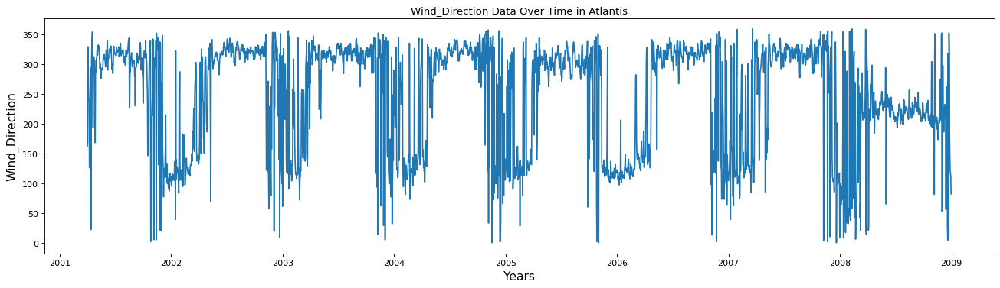

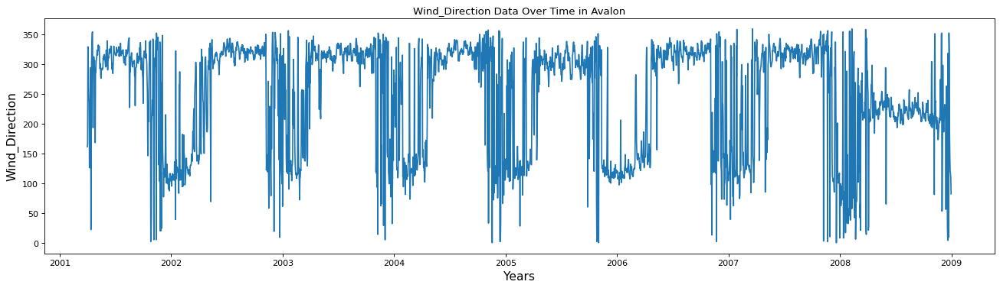

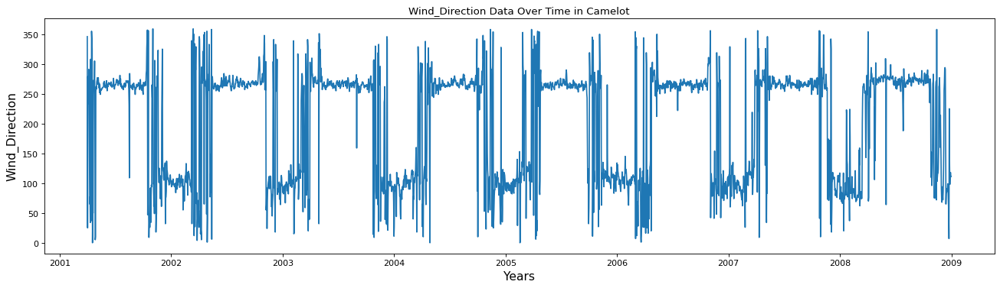

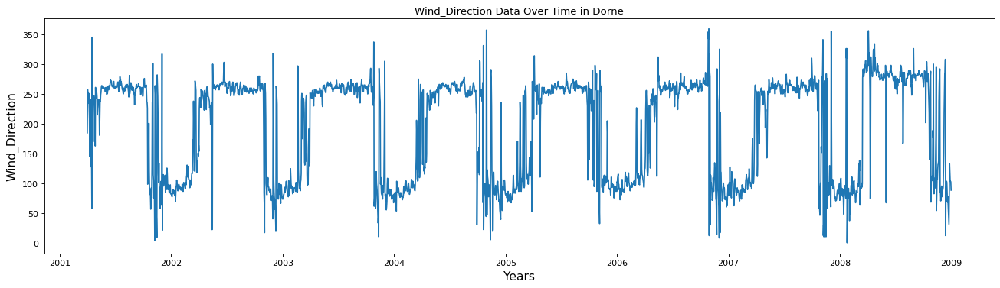

...

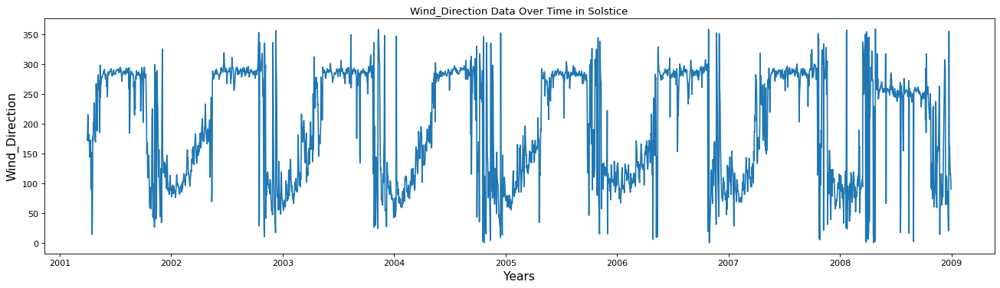

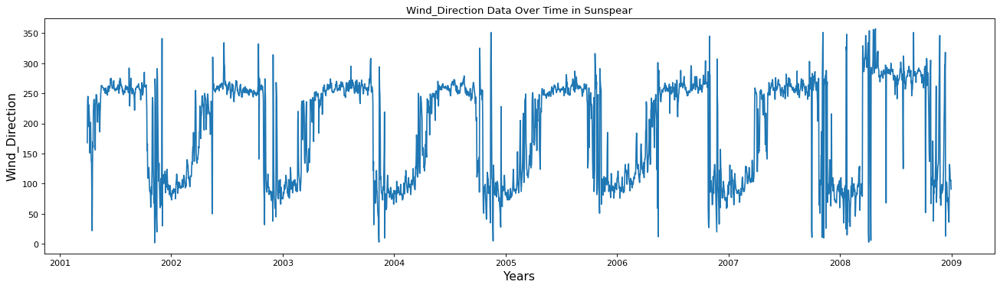

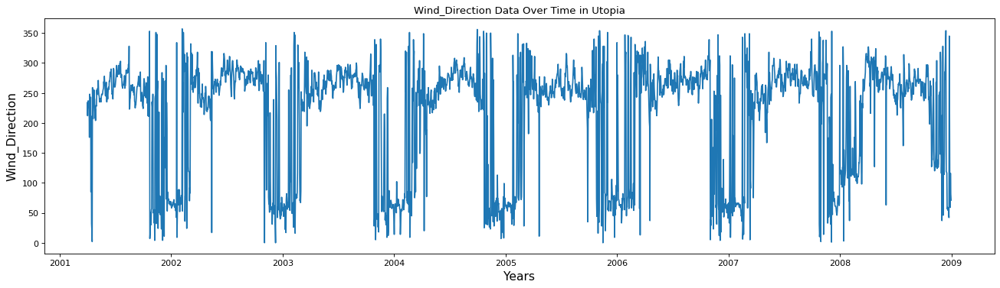

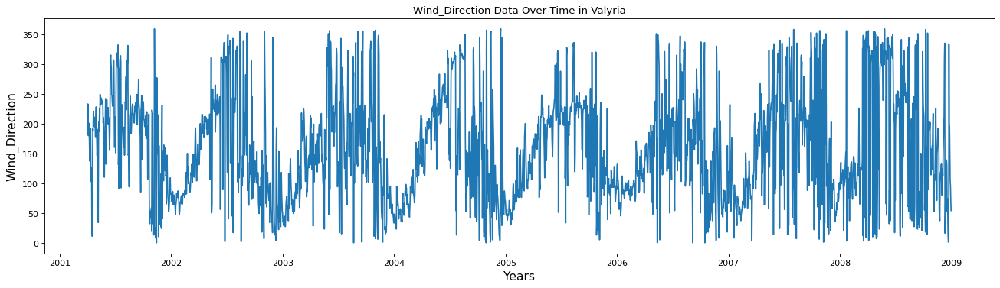

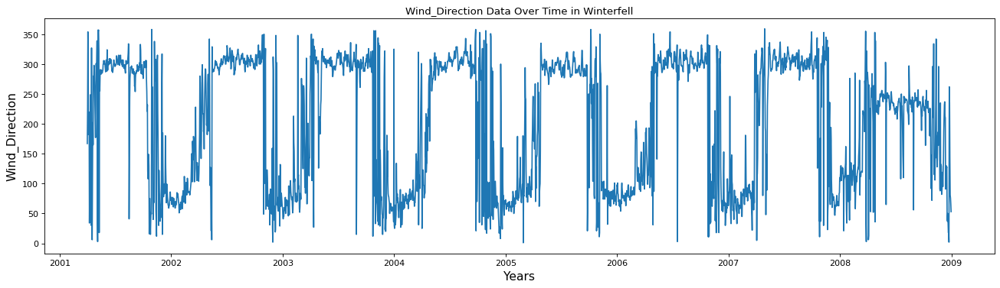

In [206]:
selected_target = "Wind_Direction"

for kingdom in kingdoms:
  filtered_df = train_df.query(f"kingdom == '{kingdom}'")
  plt.figure(figsize=(20, 5), dpi=80, linewidth=10)
  plt.plot(filtered_df["ds"], filtered_df[selected_target])
  plt.title(f"{selected_target} Data Over Time in {kingdom}")
  plt.xlabel("Years", fontsize=14)
  plt.ylabel(f'{selected_target}', fontsize=14)
  plt.show()

We can see that there is clear seasonality in most of the target variables, but there also seems to be anomalous values present in the `Rain_Amount` column. These must be handled appropriately before training the model.

In [208]:
# Handle outliers in `Rain_Amount`

def remove_outliers_iqr(df, column, threshold=1.5):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - threshold * IQR
    upper_bound = Q3 + threshold * IQR

    # Keep non-outliers (including zeros)
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

# Apply to Rain_Amount
train_df = remove_outliers_iqr(train_df, 'Rain_Amount')

Let's inspect `Rain_Amount` again to see if the outliers have been handled appropriately.

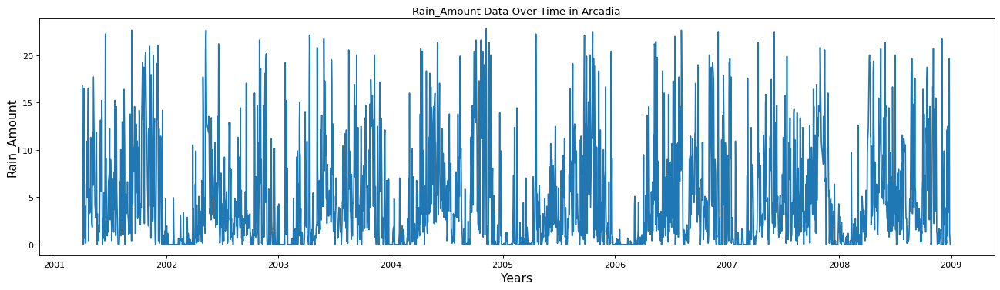

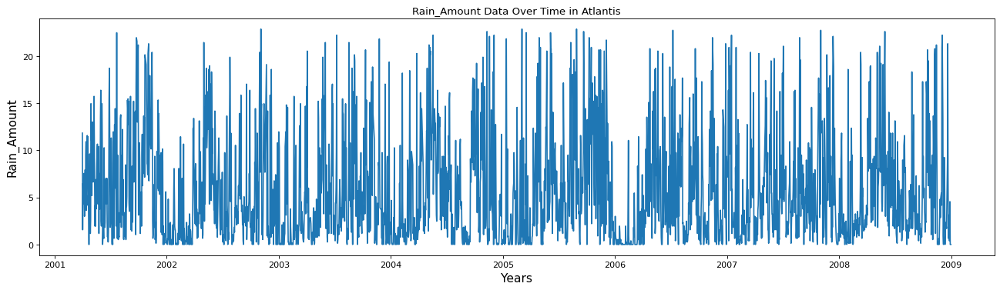

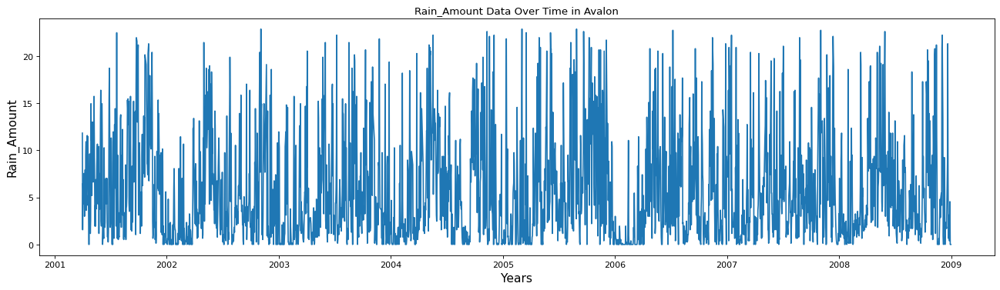

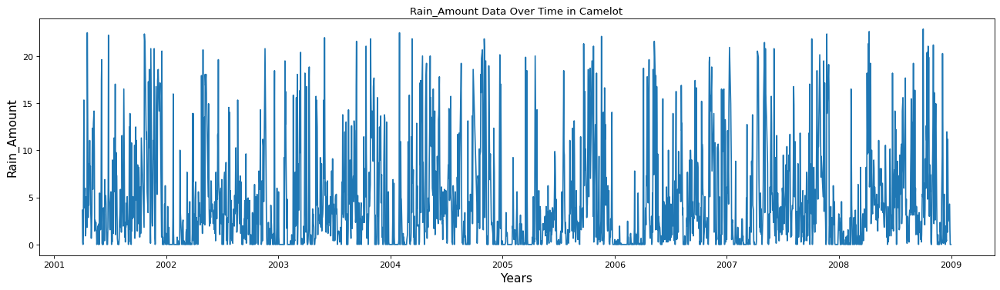

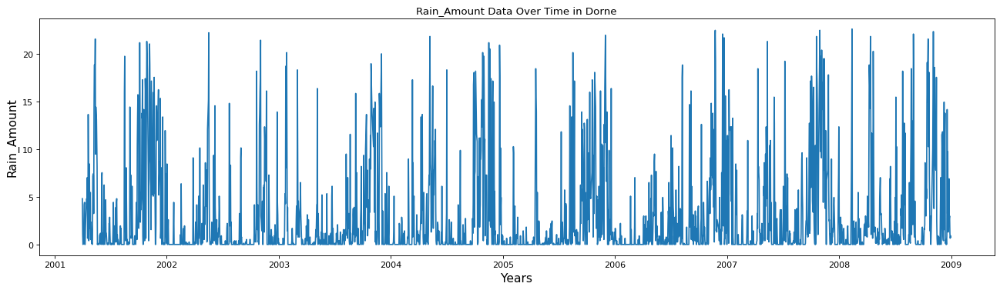

...

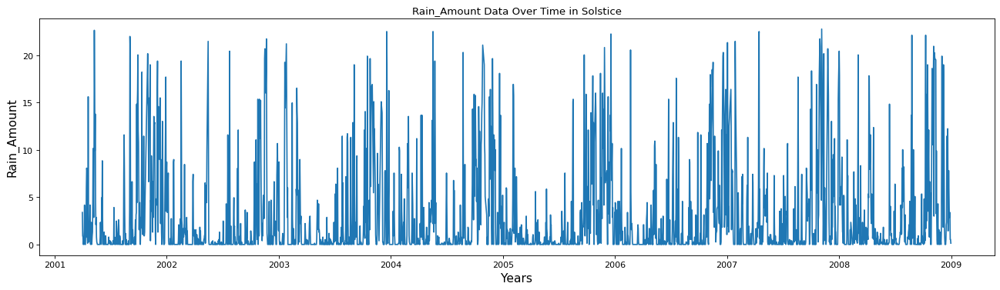

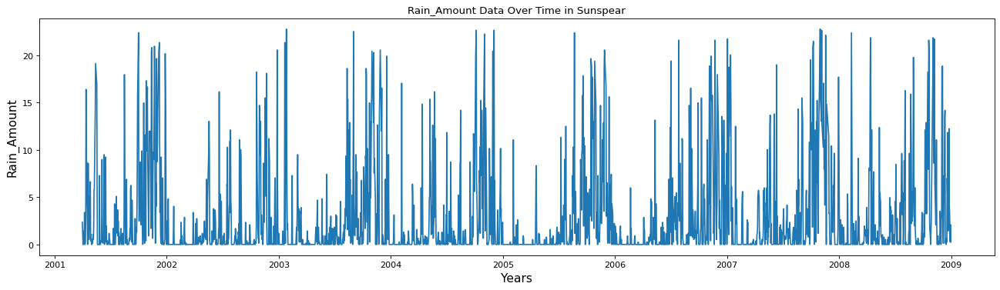

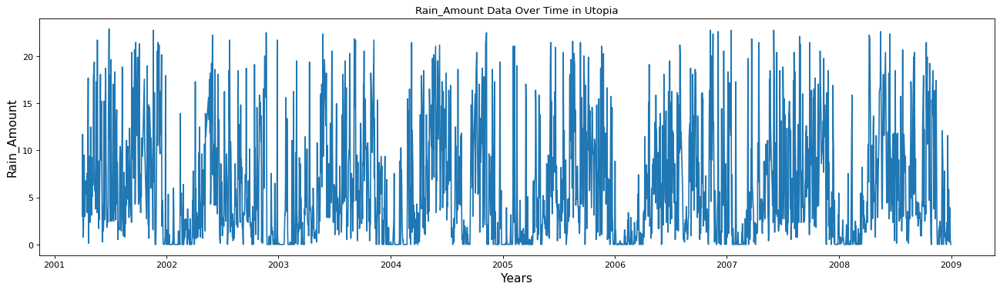

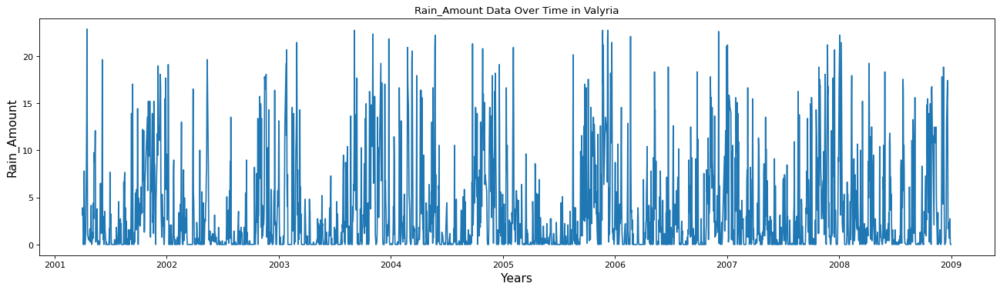

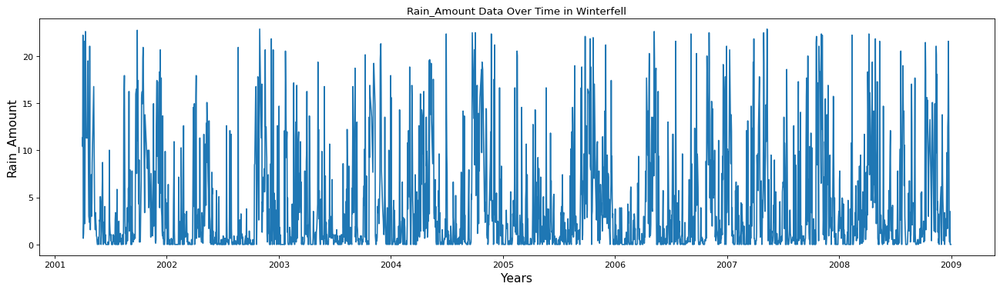

In [209]:
selected_target = "Rain_Amount"

for kingdom in kingdoms:
  filtered_df = train_df.query(f"kingdom == '{kingdom}'")
  plt.figure(figsize=(20, 5), dpi=80, linewidth=10)
  plt.plot(filtered_df["ds"], filtered_df[selected_target])
  plt.title(f"{selected_target} Data Over Time in {kingdom}")
  plt.xlabel("Years", fontsize=14)
  plt.ylabel(f'{selected_target}', fontsize=14)
  plt.show()

Next, let's develop a separate dataframe to store the model's predictions for submission.

In [210]:
# Prepare the submission dataframe
submission_df = test_df[['ID']].copy()

# Initialize all target columns with zeros
for target in targets:
    submission_df[target] = 0.0

submission_df.head()

,ID,Avg_Temperature,Radiation,Rain_Amount,Wind_Speed,Wind_Direction
0,84961,0.0,0.0,0.0,0.0,0.0
1,84962,0.0,0.0,0.0,0.0,0.0
2,84963,0.0,0.0,0.0,0.0,0.0
3,84964,0.0,0.0,0.0,0.0,0.0
4,84965,0.0,0.0,0.0,0.0,0.0


In [211]:
submission_df.shape

(4530, 6)

---

## Model Training

Now, we can develop our model training loop, train the model and perform predictions using it for the test data.

After several experiments, we have picked **Facebook Prophet** as the most effective model for our purpose.

In [212]:
# Full training and prediction loop

# Outer loop: iterate over kingdoms
for kingdom in tqdm(kingdoms, desc="Kingdoms"):
    kingdom_test = test_df[test_df['kingdom'] == kingdom]

    # Inner loop: iterate over targets (for each kingdom)
    for var in tqdm(targets, desc=f"Variables", leave=False):
        df = train_df[train_df['kingdom'] == kingdom][['ds', var]].rename(columns={var: 'y'})

        # Initialize Prophet
        model = Prophet(
          yearly_seasonality=True,
          weekly_seasonality=True,
          daily_seasonality=False,
          seasonality_mode='multiplicative',
          growth="flat",
        )

        # Fit model
        model.fit(df)

        # Create future dates matching test period
        future = model.make_future_dataframe(periods=151)

        # Predict
        forecast = model.predict(future)

        # Align with test dates
        preds = forecast.set_index('ds').reindex(kingdom_test['ds'])['yhat']

        # Store predictions
        submission_df.loc[kingdom_test.index, var] = preds.values

Variables:   0%|          | 0/5 [00:00<?, ?it/s]DEBUG:cmdstanpy:input tempfile: /tmp/tmpbbeik3w5/gk5lfrnf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbbeik3w5/be6i524j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71367', 'data', 'file=/tmp/tmpbbeik3w5/gk5lfrnf.json', 'init=/tmp/tmpbbeik3w5/be6i524j.json', 'output', 'file=/tmp/tmpbbeik3w5/prophet_model90re84i5/prophet_model-20250403171216.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
17:12:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
17:12:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing

Variables:  20%|██        | 1/5 [00:00<00:03,  1.29it/s]DEBUG:cmdstanpy:input tempfile: /tmp/tmpbbeik3w5/gq49d49x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbbeik3w5/646bnq9u.json
DEBUG:cmdst

In [213]:
# Inspect the submission dataframe
submission_df.head()

,ID,Avg_Temperature,Radiation,Rain_Amount,Wind_Speed,Wind_Direction
0,84961,24.961523,19.718328,1.696698,14.763569,80.684579
1,84962,26.833402,21.913405,2.924922,12.420636,141.904189
2,84963,26.167313,21.913405,2.924922,12.420636,141.904189
3,84964,22.294151,19.106760,1.687891,10.713325,91.047300
4,84965,25.669811,18.467182,1.574686,22.181736,85.410931


Since the submission dataframe's predictions have several decimal points in them, we can bring this down to 2 decimal places to match the training data as much as possible.

In [214]:
# Round off float values in submission dataframe to 2 decimal places
cols_to_round = ['Avg_Temperature', 'Radiation', 'Rain_Amount', 'Wind_Speed', 'Wind_Direction']
submission_df[cols_to_round] = submission_df[cols_to_round].round(2)

In [215]:
# Inspect shape of submission dataframe
submission_df.shape

(4530, 6)

Finally, we can save the output dataframe as a CSV file for submission.

In [216]:
# Save results
submission_df.to_csv('caramel_labs_submission.csv', index=False)